In [1]:
from dask.distributed import Client, LocalCluster
from dask import delayed, dataframe as dd
import dask

import pandas as pd
import dask.dataframe as dd
import geopandas as gpd
import math
import numpy as np

import momepy

import matplotlib.pyplot as plt
import geopandas as gpd

/tmp/ipykernel_683/1812556411.py:7: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS functions on geometries from GeoPandas), this will then stop working and you are encouraged to migrate from PyGEOS to Shapely 2.0 (https://shapely.readthedocs.io/en/latest/migration_pygeos.html).
  import geopandas as gpd


In [2]:
Daskcluster = LocalCluster(threads_per_worker=2,
                n_workers=8, memory_limit='100GB')

client = Client(Daskcluster)
client

2023-04-11 11:10:46,823 - distributed.worker_memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 15.58 GiB
2023-04-11 11:10:46,825 - distributed.worker_memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 15.58 GiB
2023-04-11 11:10:46,826 - distributed.worker_memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 15.58 GiB
2023-04-11 11:10:46,828 - distributed.worker_memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 15.58 GiB
2023-04-11 11:10:46,831 - distributed.worker_memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 15.58 GiB
2023-04-11 11:10:46,832 - distributed.worker_memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 15.58 GiB
2023-04-11 11:10:46,835 - distributed.worker_memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 15.58 GiB
2023-04-11 11

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 8
Total threads: 16,Total memory: 124.66 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:33009,Workers: 8
Dashboard: http://127.0.0.1:8787/status,Total threads: 16
Started: Just now,Total memory: 124.66 GiB
Comm: tcp://127.0.0.1:42839,Total threads: 2
Dashboard: http://127.0.0.1:42513/status,Memory: 15.58 GiB
Nanny: tcp://127.0.0.1:45531,


In [3]:
streets = gpd.read_parquet("./out/singapore/streets.pq").explode()

buildings = gpd.read_parquet("./out/singapore/buildings.pq")

study_area = gpd.read_parquet("./out/singapore/study_area.pq")

water = gpd.read_parquet("./out/singapore/water.pq")

/tmp/ipykernel_683/2478841633.py:1: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  streets = gpd.read_parquet("./out/singapore/streets.pq").explode()


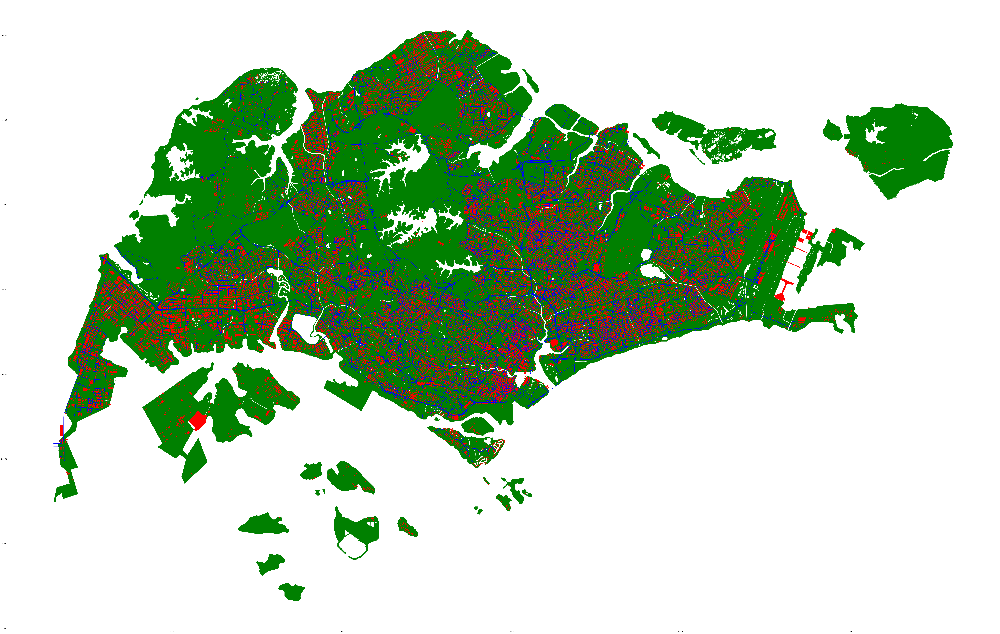

In [5]:
# Create a figure and axis
fig, ax = plt.subplots(figsize=(100, 100))

# Plot study_area in green on the same axis
study_area.plot(ax=ax, color='green')

# Plot streets in blue on the same axis
streets.plot(ax=ax, color='blue')

# Plot buildings in red on the same axis
buildings.plot(ax=ax, color='red')

# Show the plot
plt.show()

In [6]:
enclosures = momepy.enclosures(streets, limit= study_area)

In [7]:
tessellation = momepy.Tessellation(buildings, unique_id='uID', enclosures=enclosures, use_dask = True).tessellation

# for debugging
tessellation_copy = tessellation

/home/virgilxw/miniconda3/lib/python3.10/site-packages/momepy/coins.py:15: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS functions on geometries from GeoPandas), this will then stop working and you are encouraged to migrate from PyGEOS to Shapely 2.0 (https://shapely.readthedocs.io/en/latest/migration_pygeos.html).
  import geopandas as gpd
/home/virgilxw/miniconda3/lib/python3.10/site-packages/momepy/coins.py:15: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. 

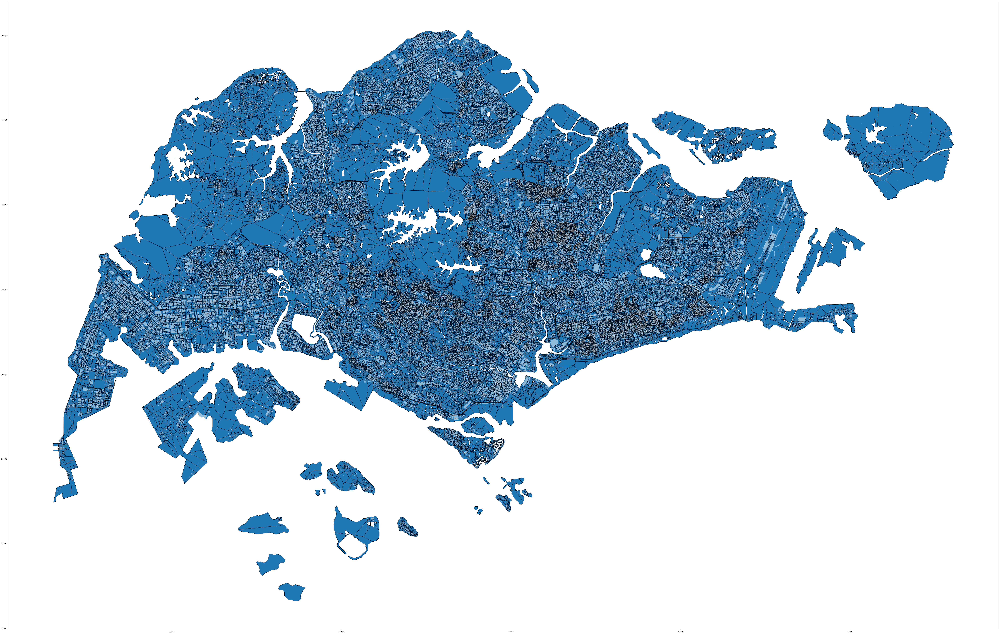

In [21]:
f, ax = plt.subplots(figsize=(100, 100))
tessellation.plot(ax=ax, edgecolor='black')
buildings.plot(ax=ax, color='white', alpha=.5)
plt.show()